In [66]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [67]:
df = pd.read_csv("airData.csv")
df = df.drop('Station_No', axis=1)
df.head()

for i in range (len(df["date"])):
    if df["date"][i].find('/') != -1 :
        df["date"][i]= df["date"][i].replace('/','-')

C:\Users\AD\AppData\Local\Temp\ipykernel_9140\3826596172.py:7: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df["date"][i]= df["date"][i].replace('/','-')
C:\Users\AD\AppData\Local\Temp\ipykernel_9140\3826596172.py:7: SettingWithCopyWarning:

In [68]:
df.columns = df.columns.str.lstrip()
df.columns = df.columns.str.rstrip()
df.index = pd.to_datetime(df.date, dayfirst= True)
df = df.drop(columns='date',axis=1)
print(len(df))

# plt.figure(figsize=(15, 10))
# sns.histplot(df._tempm, bins = [i for i in range (0, 61, 5)], kde = False )
# plt.grid()
# plt.show()

52548


In [69]:
# cols =  ['_dewptm', '_fog','_hail', '_hum','_rain', '_snow', '_tempm', '_thunder', '_tornado'] 
# df = df [cols]
# df.head()

In [70]:
df.isna().sum()

TSP               60
PM2.5              0
O3             10610
CO              9065
NO2             5666
SO2            11006
Temperature     4437
Humidity        4432
dtype: int64

In [71]:
# df = df.fillna(method = 'ffill')
df = df.dropna()
len(df)

32509

In [72]:
df.isna().sum()

TSP            0
PM2.5          0
O3             0
CO             0
NO2            0
SO2            0
Temperature    0
Humidity       0
dtype: int64

In [73]:
df_final = df.resample('D').mean()
df_final.head()

,TSP,PM2.5,O3,CO,NO2,SO2,Temperature,Humidity
date,,,,,,,,
2021-02-23,26.271525,13.235970,75.751816,1190.404468,84.655254,372.293777,28.201846,64.528641
2021-02-24,32.741897,15.929745,61.167655,1048.433241,69.503830,337.329287,27.508296,64.900866
2021-02-25,26.361153,13.298236,49.566412,923.845816,64.240951,350.883281,27.910777,66.225786
2021-02-26,45.569351,22.128216,55.518728,1435.979952,67.287059,343.583925,27.740009,69.505777
2021-02-27,69.470393,32.433861,48.354882,968.084646,62.885535,417.827461,29.187368,69.267263


In [74]:
# df_final = df_final.fillna(method = 'ffill') 
# df_final.isna().sum()
# df_final.head()

df = df.fillna(method='ffill')
df.isna().sum()
len(df)

C:\Users\AD\AppData\Local\Temp\ipykernel_9140\447845852.py:5: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  df = df.fillna(method='ffill')


32509

In [75]:
from sklearn.preprocessing import MinMaxScaler

#Normalize the data
scaler = MinMaxScaler()
scaled_data = scaler.fit_transform(df)

#Define sequence length and features
sequence_length = 10
num_features = len(df.columns)

#create sequences and corresponding lables
sequences = []
labels = []
  
for i in range(len(scaled_data) - sequence_length):
    seq = scaled_data[i:i+sequence_length]
    label = scaled_data[i + sequence_length][3]
    sequences.append(seq)
    labels.append(label)

sequences = np.array(sequences)
labels = np.array(labels)

trainSize = int(0.8 * len(sequences))
train_x, test_x = sequences[0:trainSize], sequences[trainSize:] 
train_y, test_y = labels[0:trainSize], labels[trainSize:]

print(train_x.shape)
print(train_y.shape)




(25999, 10, 8)
(25999,)


In [76]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

#Create the LSTM model
model = Sequential()

#add LSTM layer with dropout
model.add(LSTM(units=128, input_shape =(train_x.shape[1], train_x.shape[2]), return_sequences = True))
model.add(Dropout(0.2))

model.add(LSTM(units=64, return_sequences = True))
model.add(Dropout(0.2))

model.add(LSTM(units=32, return_sequences = False))
model.add(Dropout(0.2))

#add dense output layer
model.add(Dense(units = 1))

#compile the model
model.compile(optimizer = "adam", loss= 'mean_squared_error')



c:\Users\AD\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


In [77]:
#Define callback
early_stopping= EarlyStopping(monitor='val_loss', patience= 5, restore_best_weights=True)

#Train model
history = model.fit(
    train_x, train_y, 
    epochs = 100,
    batch_size = 64, 
    validation_split = 0.2,
    callbacks = early_stopping,
    validation_data = (test_x, test_y)   
)


Epoch 1/100
407/407 ━━━━━━━━━━━━━━━━━━━━ 8s 12ms/step - loss: 0.0022 - val_loss: 0.0034
Epoch 2/100
407/407 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 0.0012 - val_loss: 0.0021
Epoch 3/100
407/407 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 8.2244e-04 - val_loss: 0.0020
Epoch 4/100
407/407 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 8.0433e-04 - val_loss: 0.0019
Epoch 5/100
407/407 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 7.8275e-04 - val_loss: 0.0018
Epoch 6/100
407/407 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 7.4268e-04 - val_loss: 0.0016
Epoch 7/100
407/407 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 6.5522e-04 - val_loss: 0.0017
Epoch 8/100
407/407 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 7.8427e-04 - val_loss: 0.0016
Epoch 9/100
407/407 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 6.9711e-04 - val_loss: 0.0017
Epoch 10/100
407/407 ━━━━━━━━━━━━━━━━━━━━ 5s 11ms/step - loss: 7.6248e-04 - val_loss: 0.0016
Epoch 11/100
407/407 ━━━━━━━━━━━━━━━━━━━━ 5s 12ms/step - loss: 7.5087e-04 - val_loss: 0

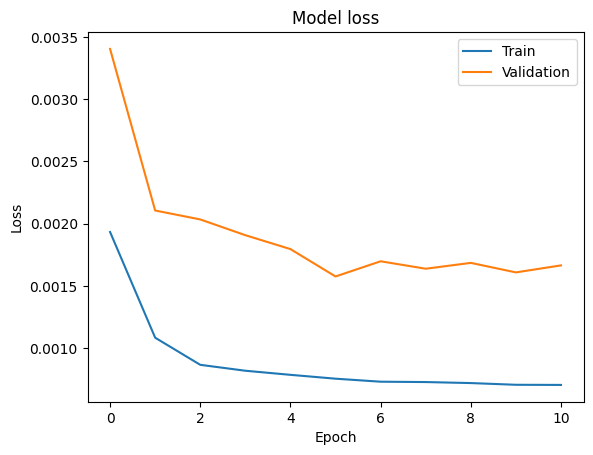

In [78]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper right')
plt.show()

In [79]:
from sklearn.metrics import mean_absolute_error, mean_squared_error

# Assuming you have trained the model and have the 'best_model' object
# Also, 'test_x' and 'test_y' should be available

# Predict temperatures using the trained model
predictions = model.predict(test_x)

# Calculate evaluation metrics
mae = mean_absolute_error(test_y, predictions)
mse = mean_squared_error(test_y, predictions)
rmse = np.sqrt(mse)

print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("Root Mean Squared Error (RMSE):", rmse)
     

204/204 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step
Mean Absolute Error (MAE): 0.025933668307681308
Mean Squared Error (MSE): 0.0015753644823989668
Root Mean Squared Error (RMSE): 0.039690861446924616


In [86]:
import sklearn.metrics as metrics
from sklearn import confusion_matrix

#accuracy = metrics.accuracy_score(test_y, predictions) 
ms = metrics.confusion_matrix(test_y, predictions)
print(ms)
# metrics.recall_score(test_y, predictions)
# metrics.precision_score(test_y, predictions)

ImportError: cannot import name 'confusion_matrix' from 'sklearn' (c:\Users\AD\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\__init__.py)

In [ ]:
# y_true values
test_y_copies = np.repeat(test_y.reshape(-1, 1), test_x.shape[-1], axis=-1)
true_temp = scaler.inverse_transform(test_y_copies)[:,3]

# predicted values
prediction = model.predict(test_x)
prediction_copies = np.repeat(prediction, 8, axis=-1)
predicted_temp = scaler.inverse_transform(prediction_copies)[:,3]

204/204 ━━━━━━━━━━━━━━━━━━━━ 1s 4ms/step


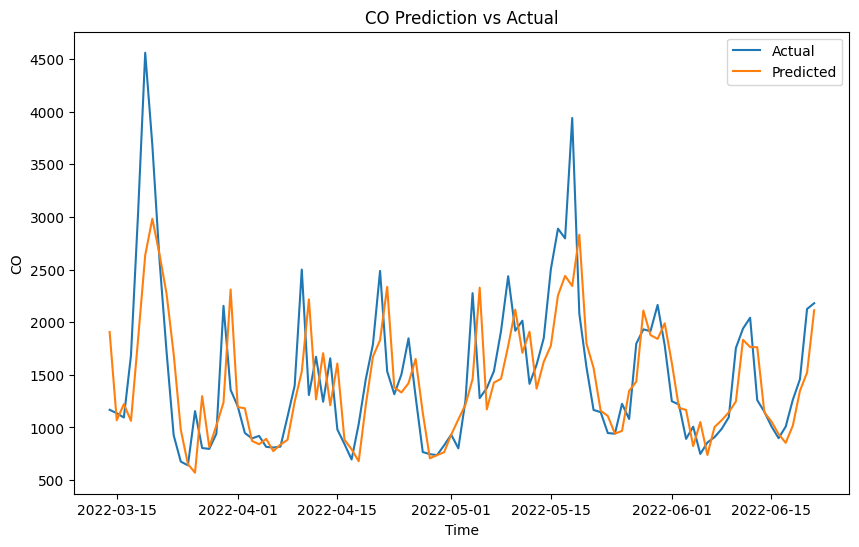

In [ ]:
# Plotting predicted and actual temperatures
plt.figure(figsize=(10, 6))
plt.plot(df_final.index[-100:], true_temp[-100:], label='Actual')
plt.plot(df_final.index[-100:], predicted_temp[-100:], label='Predicted')
plt.title('CO Prediction vs Actual')
plt.xlabel('Time')
plt.ylabel('CO')
plt.legend()
plt.show()
     